In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


<font color='red'>**Changes in this version:**</font>



- These two lines in the dataset
```
self.images = os.listdir(image_dir)[int(number_of_samples*split_ratio):]
self.masks = os.listdir(mask_dir)[int(number_of_samples*split_ratio):]
```
Have been changed to:
```
self.images = self.images[int(number_of_samples*split_ratio):]
self.masks = self.images[int(number_of_samples*split_ratio):]
```

- The comment defining the mask output in the dataset, has been changed from
```
onehot_mask (torch.Tensor): One-hot encoded mask tensor for segmentation.
```
to
```
mask (torch.Tensor): Mask tensor for segmentation.
```

- `model` is transfered to `cpu` before saving the weights.

- There was a mistake in the previous update
```
self.masks = self.images[int(number_of_samples*split_ratio):]
```
has been changed to:
```
self.masks = self.masks[int(number_of_samples*split_ratio):]
```

<font color='red'>IMPORTANT</font>: The output of your model should be logits.

## Problem Definition

We are addressing a **semantic segmentation problem**, specifically focusing on **teeth caries CT scans**. The dataset contains **teeth scans** along with their corresponding **segmentation masks**. The task involves segmenting the CT scan images to accurately identify regions affected by caries.

The objective is to develop a model that can effectively segment the images into the desired classes representing carious and non-carious regions. The challenge lies in optimizing the model's performance while managing memory constraints during training.

### Requirements:
- The model must be implemented using **`torch`** and **`torchvision`** only (no other deep learning libraries are allowed for the model architecture).
- The main class for the model must be named <font color='red'>**`Model`**</font>, and participants <font color='red'>**must not change this name**</font>.
- Do not change the init function inside the `Model` class.
- The size of your model must not exceed 70 MB.
- Instantiating your model must not require any parameters.


## Dataset

### Downloading the Teeth Dataset

First the dataset need to be downloaded.

In [ ]:
!pip install datasets tqdm -q
from huggingface_hub import login
from datasets import load_dataset
from huggingface_hub import snapshot_download
import os
import sys
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 472.7/472.7 kB 32.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 17.2 MB/s eta 0:00:00


In [ ]:
dataset_id="RayanAi/Main_teeth_dataset"
# Set the local directory where you want to store the dataset
local_dataset_dir = "./Main_teeth_dataset"  # You can change this path to your desired location

# Create the directory if it doesn't exist
os.makedirs(local_dataset_dir, exist_ok=True)

# Suppress the output by redirecting it to os.devnull
with open(os.devnull, 'w') as fnull:
    # Save the original stdout
    original_stdout = sys.stdout
    try:
        # Redirect stdout to devnull to suppress output
        sys.stdout = fnull
        # Download the dataset and store it locally
        snapshot_download(repo_id=dataset_id, local_dir=local_dataset_dir, repo_type="dataset")
    finally:
        # Restore the original stdout
        sys.stdout = original_stdout

# Print message when download is complete
print("Dataset downloaded completely.")

# Calculate and print the total size of the downloaded files
total_size = 0
for dirpath, dirnames, filenames in os.walk(local_dataset_dir):
    for f in filenames:
        fp = os.path.join(dirpath, f)
        total_size += os.path.getsize(fp)

# Convert size to MB and print
print(f"Total size of downloaded files: {total_size / (1024 * 1024):.2f} MB")

# Get the absolute path of the dataset directory and print it
dataset_abs_path = os.path.abspath(local_dataset_dir)
print(f"Dataset has been saved at: [{dataset_abs_path}]")


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

Main_teeth_dataset.zip:   0%|          | 0.00/90.2M [00:00<?, ?B/s]

.gitattributes:   0%|          | 0.00/2.42k [00:00<?, ?B/s]

Dataset downloaded completely.
Total size of downloaded files: 86.07 MB
Dataset has been saved at: [/content/Main_teeth_dataset]


In [ ]:
!unzip -q ./Main_teeth_dataset/Main_teeth_dataset.zip -d ./Main_teeth_dataset/

### Handling Dataset

In [ ]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn.functional as F
from torch.utils.data import Dataset

import albumentations as A
from albumentations.pytorch import ToTensorV2
#Define the split ratio
split_ratio = 0.8

#Write a Dataset function called TeethSegmentationDataset


#Write a Dataset function called TeethSegmentationDataset
class TeethSegmentationDataset(Dataset):
    def __init__(self, image_dir: str, mask_dir: str, transform: A.Compose, dataset_type: str = 'Train', noisy_masks: list = None):
        """
        Args:
            image_dir (str): Directory path containing input images.
            mask_dir (str): Directory path containing corresponding segmentation masks.
            transform (callable): Optional transformation to be applied to both the image and the mask. Use A.Compose. Use ToTensorV2()
            dataset_type (str, optional): Type of dataset, e.g., 'Train' or 'Test'. Defaults to 'Train'.
            noisy_masks (list, optional): Provide a list of names for images you want to be excluded from dataset
        """
        # Initialize paths and transformation
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.dataset_type = dataset_type

        # List of all images and masks
        self.images = os.listdir(image_dir)
        self.masks = os.listdir(mask_dir)
        # Filter out noisy masks if provided
        if noisy_masks:
            self.images = [img for img in self.images if img not in noisy_masks]
            self.masks = [mask for mask in self.masks if mask not in noisy_masks]
        number_of_samples = len(self.images)

        if dataset_type == 'Train':
            self.images = self.images[:int(number_of_samples*split_ratio)]
            self.masks = self.masks[:int(number_of_samples*split_ratio)]
        elif dataset_type == 'Test':
            self.images = self.images[int(number_of_samples*split_ratio):]
            self.masks = self.masks[int(number_of_samples*split_ratio):]



    def __len__(self) -> int:
        """
        Returns:
            int: The total number of image-mask pairs in the designated dataset split.
        """
        # Return the length of the dataset (number of images)
        return len(self.images)


    def __getitem__(self, index: int) -> tuple[torch.Tensor, torch.Tensor]:
        """
        Args:
            index (int): Index of the image-mask pair to retrieve.

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: A tuple containing the image and its corresponding one-hot encoded mask.
                - image (torch.Tensor): Transformed image tensor.
                - mask (torch.Tensor): Mask tensor for segmentation.
        """
        # Load the image and mask
        image_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(self.mask_dir, self.masks[index])

        # Load image and mask as grayscale
        image = np.array(Image.open(image_path).convert("L"))
        mask = np.array(Image.open(mask_path).convert("L"))
        transformed = self.transform(image=image, mask=mask)
        image = transformed['image']
        mask = transformed['mask']
        binary_mask = mask.unsqueeze(2)>0
        binary_mask = binary_mask.permute(2, 0, 1).float()

        return image, binary_mask

In [ ]:
######################augmenters######################
#You may want to alter this part
augmenter = A.Compose([
    A.Normalize(mean=(0.485,), std=(0.229,), max_pixel_value=255.0),
    ToTensorV2(),
])

######################################################

######################################################
#Don't touch this part
test_augmenter = A.Compose([
    A.Normalize(mean=(0.485,), std=(0.229,), max_pixel_value=255.0),
    ToTensorV2(),
])
######################################################

train_dataset = TeethSegmentationDataset(
    image_dir="./Main_teeth_dataset/images",
    mask_dir="./Main_teeth_dataset/labels",
    transform=augmenter,
    dataset_type='Train',

)

test_dataset = TeethSegmentationDataset(
    image_dir= "./Main_teeth_dataset/images",
    mask_dir="./Main_teeth_dataset/labels",
    transform=test_augmenter,
    dataset_type='Test',

)

/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [ ]:
from torch.utils.data import DataLoader
batch_size=8
num_workers=0 # Increase this if you have a powerfull cpu
dataloaders = {
  'train': DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers),
  'test': DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)
}
print(f"Train dataset size: {len(train_dataset)}")
print(f"Test dataset size: {len(test_dataset)}")


# Segmentation model
In this part you should design a segmentation model. If you have defined any functions used to define your model, you should upload it along the model code.

Your model shouldn't take any inputs or produce outputs when instantiating.

<font color='red'>Important: You can only use functions availble in `torch` and `torchvision`.</font>

In [ ]:
import torch.nn as nn


class Model(nn.Module):
    def __init__(self):
        super().__init__()
        # Add your code here


    #######DO NOT CHANGE THIS PART########
    def init(self):
        self.load_state_dict(torch.load('model.pth',weights_only=True))
    ######################################

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """
        This method defines the forward pass of the model.

        Args:
            x (tensor): The input tensor, in the shape of (batch_size,1,512,512).

        Returns:
            mask (tensor): The output tensor logits, in the shape of (batch_size,1,512,512).
        """
        # Add you code here
        return mask

In [ ]:
model = Model().to(device)

image = next(iter(dataloaders['train']))[0].to(device)
out = model(image)
print(image.shape)
print(out.shape)
assert image.shape == (batch_size, 1, 512, 512), "You shouldn't change the size of the image"
assert out.shape == (batch_size, 1, 512, 512), "The output of your model do not have correct dimensions"

## Dice Score

Here is the dice score function. You model is evaluated based on the score from this function

In [ ]:
def dice_score(pred: torch.Tensor, target_mask: torch.Tensor, epsilon: float = 1e-6) -> float:
    """
    Computes the Dice score between the predicted and target segmentation masks.

    Args:
        pred (torch.Tensor): The predicted mask tensor, with values in range [0, 1].
        target_one_target_maskhot (torch.Tensor): The ground truth mask.
        epsilon (float, optional): A small value to avoid division by zero. Defaults to 1e-6.

    Returns:
        float: The Dice score, a similarity metric between 0 and 1.
    """
    pred = pred>0
    pred_flat = pred.contiguous().view(pred.shape[0], pred.shape[1], -1)
    target_flat = target_mask.contiguous().view(target_mask.shape[0], target_mask.shape[1], -1)

    intersection = (pred_flat * target_flat).sum(dim=-1)
    union = pred_flat.sum(dim=-1) + target_flat.sum(dim=-1)

    dice = (2. * intersection + epsilon) / (union + epsilon)

    dice_mean = dice.mean(dim=1)

    return dice_mean.mean()



## Training

In [ ]:
#Define your optimizer and loss function
#You can either use predefined loss functions or define one your self

criterion =
optimizer =


In [ ]:
import matplotlib.pyplot as plt
def visualize_mask(inputs: torch.Tensor, masks: torch.Tensor, outputs: torch.Tensor):
    # Convert tensors to numpy for visualization
    sample_index = 0  # Index of the sample to visualize
    channel = 0
    print(f'Dice score is {dice_score(outputs[sample_index:sample_index+1,channel:channel+1],masks[sample_index:sample_index+1,channel:channel+1])}')

    inputs_np = inputs.cpu().numpy()
    masks_np = masks.cpu().numpy()
    outputs_np = outputs.detach().cpu().numpy()

    # Choose a sample to visualize

    # Plotting
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(inputs_np[sample_index].transpose(1, 2, 0), cmap='gray')  # Assuming inputs are in CxHxW format
    plt.title("Input Image")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks_np[sample_index, channel], cmap='gray')  # Display the first channel of the mask
    plt.title("Ground Truth Mask")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(outputs_np[sample_index, channel]>0, cmap='gray')  # Display the first channel of the output
    plt.title("Model Output Mask")
    plt.axis('off')

    plt.show()

The `train_model` function implements a simple training loop that iterates over a specified number of epochs. In each iteration, the model is trained on the training set and then evaluated on the validation set using the Dice score as the performance metric. The function returns the model as it is at the final epoch.

In [ ]:
import torch
import time
import matplotlib.pyplot as plt
import torchvision
import torch.optim as optim


model = model.to(device)  # Move model to GPU if available

# Training function with visualization support
def train_model(
    model: nn.Module,
    dataloaders: dict[str, DataLoader],
    criterion: nn.Module,
    optimizer: optim.Optimizer,
    num_epochs: int = 25
) -> nn.Module:
    """
    Trains the model over a specified number of epochs using the given data loaders,
    criterion (loss function), and optimizer.

    Args:
        model (nn.Module): The PyTorch model to be trained.
        dataloaders (dict[str, DataLoader]): A dictionary containing 'train' and 'test' data loaders.
        criterion (nn.Module): The loss function to be used for training.
        optimizer (torch.optim.Optimizer): The optimizer used to adjust model parameters.
        num_epochs (int, optional): Number of epochs for training. Defaults to 25.

    Returns:
        nn.Module: The trained model.
    """
    since = time.time()

    train_losses = []
    test_losses = []
    dice_scores_epoch = []

    for epoch in range(num_epochs):
        dice_scores = []
        print(f'Epoch {epoch}/{num_epochs-1}')
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'test']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0

            # Iterate over data
            for inputs, masks in dataloaders[phase]:
                inputs = inputs.to(device)
                masks = masks.to(device)

                # Zero the parameter gradients
                optimizer.zero_grad()

                # Forward
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)

                    loss = criterion(outputs,masks)

                    # Backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                    else:
                        dice_scores.append(dice_score(outputs, masks))

                # Statistics
                running_loss += loss.item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            if phase == 'train':
                train_losses.append(epoch_loss)
            else:
                test_losses.append(epoch_loss)
                dice_scores_epoch.append(torch.tensor(dice_scores).mean().item())

                visualize_mask(inputs, masks, outputs)


            print(f'{phase} Loss: {epoch_loss:.4f}')
            if phase == 'test':
                print(f'Dice score: {torch.tensor(dice_scores).mean()}')

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

    # Plot the results
    epochs_range = range(num_epochs)
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, train_losses, label="Train Loss")
    plt.plot(epochs_range, test_losses, label="Test Loss")
    plt.legend(loc="upper right")
    plt.title("Training and Test Loss")

    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, dice_scores_epoch, label="Dice Score", color="green")
    plt.legend(loc="lower right")
    plt.title("Dice Score")

    plt.show()

    return model

# Train the model
model = train_model(model, dataloaders, criterion, optimizer)

In [ ]:
model_save_path = "model.pth"
torch.save(model.cpu().state_dict(), model_save_path)

\

---





---



In [ ]:
# model.py
import torch
import torch.nn as nn

class DoubleConv(nn.Module):
    """(Convolution => BatchNorm => ReLU) * 2"""
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),

            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    """Downscaling with MaxPool then DoubleConv"""
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.down = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.down(x)

class Up(nn.Module):
    """Upscaling then DoubleConv"""
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()

        if bilinear:
            self.up = nn.Sequential(
                nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),
                nn.Conv2d(in_channels, in_channels // 2, kernel_size=1, bias=False)
            )
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)

        self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        # Calculate padding
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = nn.functional.pad(x1, [diffX // 2, diffX - diffX // 2,
                                    diffY // 2, diffY - diffY // 2])

        # Concatenate along the channels axis
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class OutConv(nn.Module):
    """Final Convolution to get desired output channels"""
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class Model(nn.Module):
    def __init__(self):
        super(Model, self).__init__()
        self.inc = DoubleConv(1, 32)
        self.down1 = Down(32, 64)
        self.down2 = Down(64, 128)
        self.down3 = Down(128, 256)
        self.up1 = Up(256, 128, bilinear=True)
        self.up2 = Up(128, 64, bilinear=True)
        self.up3 = Up(64, 32, bilinear=True)
        self.outc = OutConv(32, 1)

    #######DO NOT CHANGE THIS PART########
    def init(self):
        self.load_state_dict(torch.load('model.pth', map_location='cpu'), strict=False)
    ######################################

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """
        Forward pass of the model.

        Args:
            x (torch.Tensor): Input tensor of shape (batch_size, 1, 512, 512).

        Returns:
            torch.Tensor: Output logits tensor of shape (batch_size, 1, 512, 512).
        """
        x1 = self.inc(x)       # Shape: (batch_size, 32, 512, 512)
        x2 = self.down1(x1)    # Shape: (batch_size, 64, 256, 256)
        x3 = self.down2(x2)    # Shape: (batch_size, 128, 128, 128)
        x4 = self.down3(x3)    # Shape: (batch_size, 256, 64, 64)
        x = self.up1(x4, x3)   # Shape: (batch_size, 128, 128, 128)
        x = self.up2(x, x2)    # Shape: (batch_size, 64, 256, 256)
        x = self.up3(x, x1)    # Shape: (batch_size, 32, 512, 512)
        mask = self.outc(x)    # Shape: (batch_size, 1, 512, 512)
        return mask


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.20 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


Train dataset size: 482
Test dataset size: 121
Epoch 1/50
----------
Train Loss: 0.6310
Dice score for sample 0: 0.0082


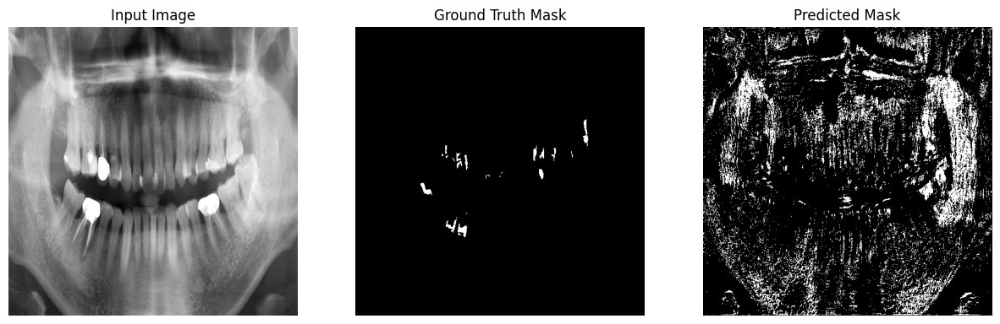

Test Loss: 0.6283 | Dice Score: 0.0775
Epoch 2/50
----------
Train Loss: 0.6311
Dice score for sample 0: 0.0060


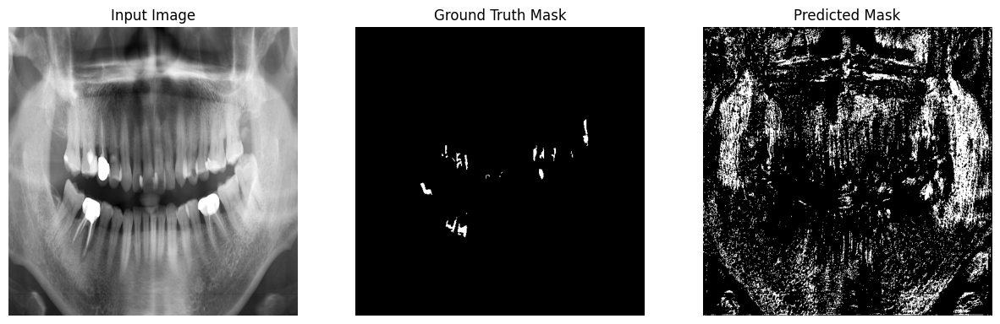

Test Loss: 0.6253 | Dice Score: 0.0814
Epoch 3/50
----------
Train Loss: 0.6311
Dice score for sample 0: 0.0061


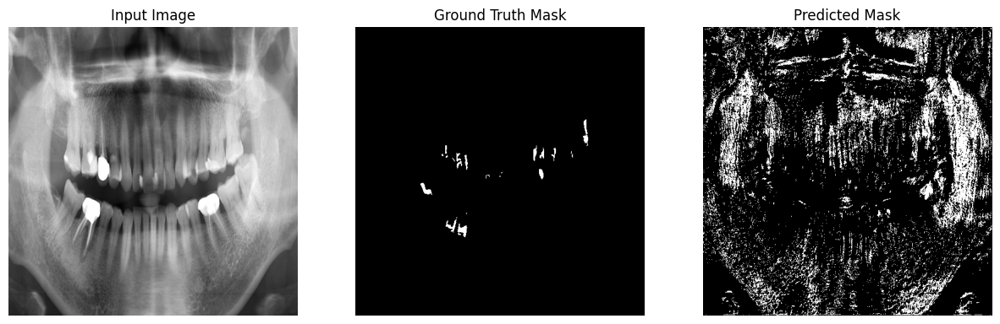

Test Loss: 0.6239 | Dice Score: 0.0822
Epoch 4/50
----------
Train Loss: 0.6346
Dice score for sample 0: 0.0060


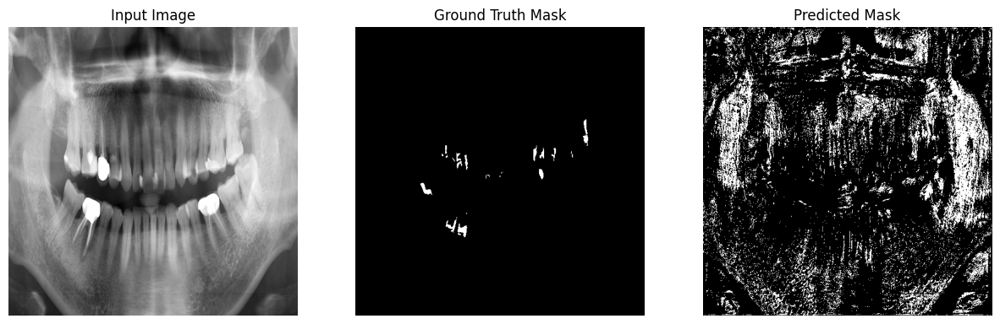

Test Loss: 0.6272 | Dice Score: 0.0834
Epoch 5/50
----------
Train Loss: 0.6320
Dice score for sample 0: 0.0066


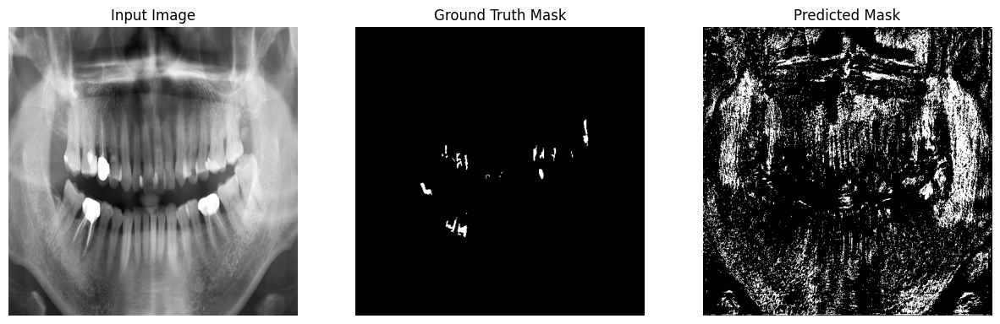

Test Loss: 0.6289 | Dice Score: 0.0841
Epoch 6/50
----------
Train Loss: 0.6300
Dice score for sample 0: 0.0063


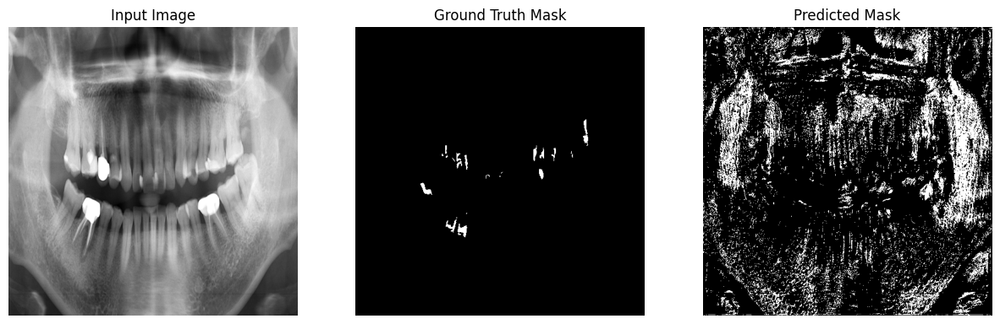

Test Loss: 0.6284 | Dice Score: 0.0846
Epoch 7/50
----------
Train Loss: 0.6304
Dice score for sample 0: 0.0063


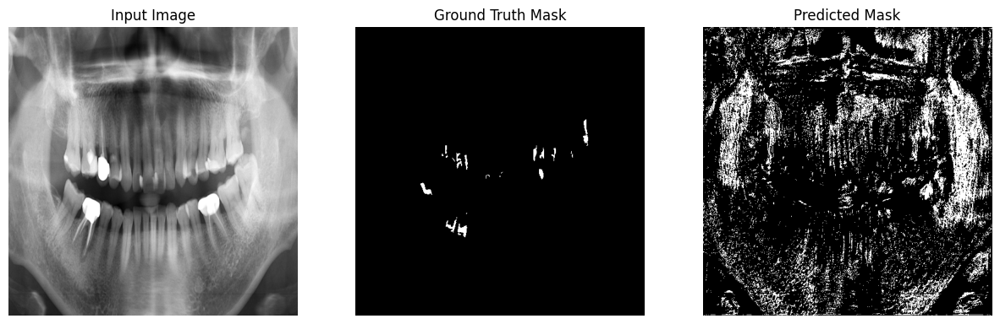

Test Loss: 0.6275 | Dice Score: 0.0832
Epoch 8/50
----------
Train Loss: 0.6304
Dice score for sample 0: 0.0061


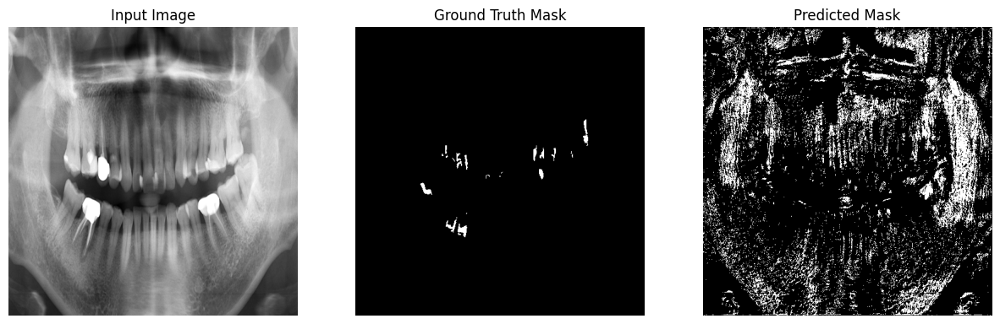

Test Loss: 0.6261 | Dice Score: 0.0831
Epoch 9/50
----------
Train Loss: 0.6298
Dice score for sample 0: 0.0058


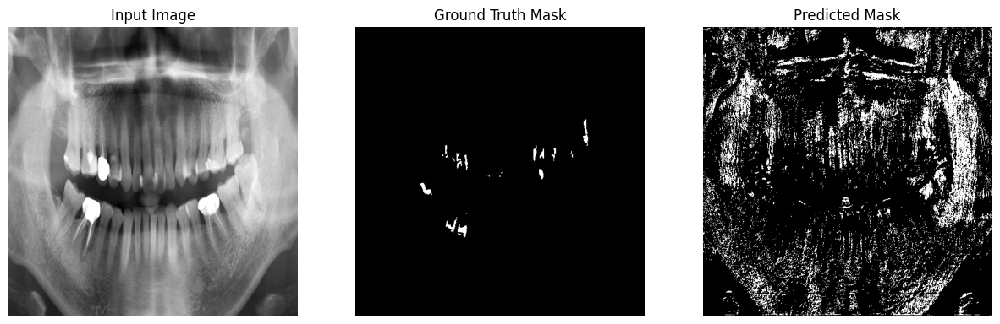

Test Loss: 0.6233 | Dice Score: 0.0819
Epoch 10/50
----------
Train Loss: 0.6317
Dice score for sample 0: 0.0062


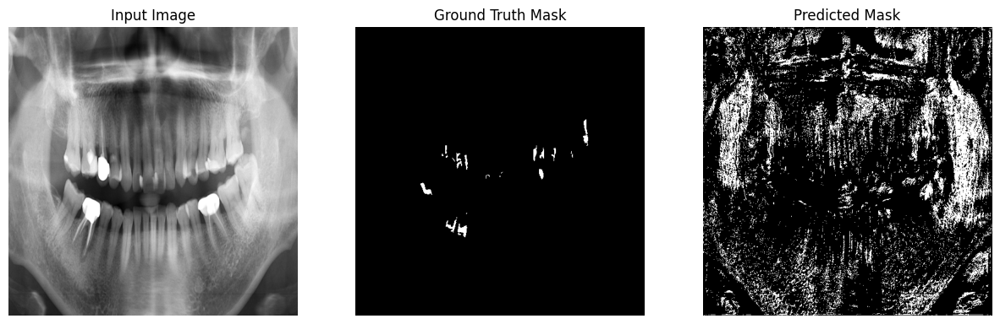

Test Loss: 0.6282 | Dice Score: 0.0840
Epoch 11/50
----------
Train Loss: 0.6326
Dice score for sample 0: 0.0062


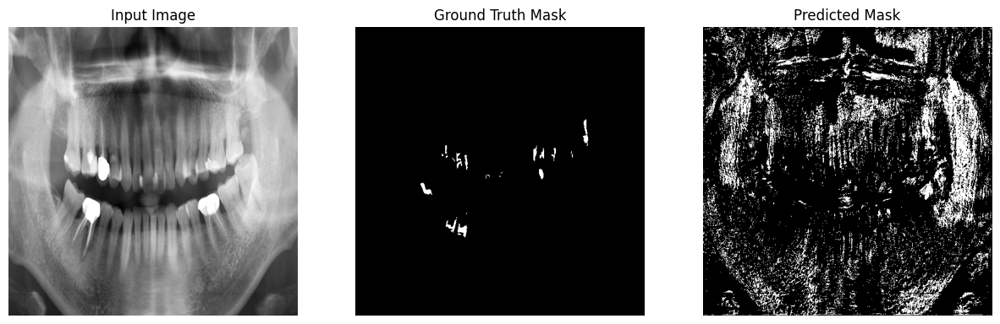

Test Loss: 0.6256 | Dice Score: 0.0817
Epoch 12/50
----------
Train Loss: 0.6318
Dice score for sample 0: 0.0066


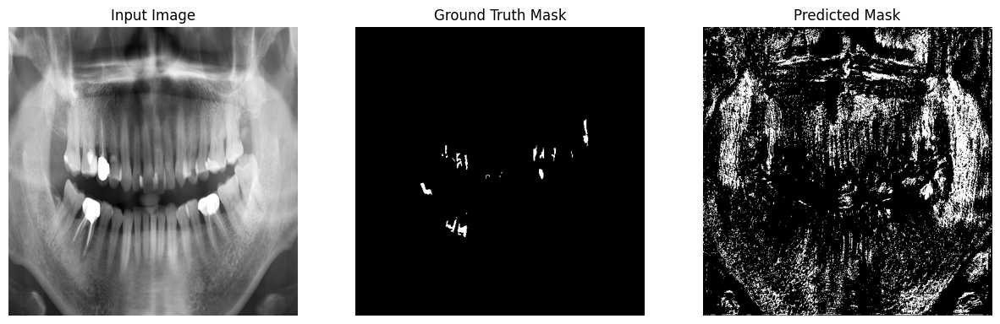

Test Loss: 0.6283 | Dice Score: 0.0835
Epoch 13/50
----------
Train Loss: 0.6291
Dice score for sample 0: 0.0063


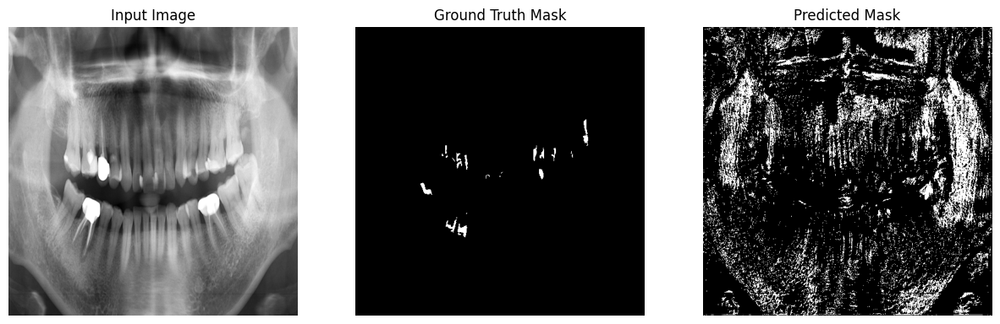

Test Loss: 0.6258 | Dice Score: 0.0823
Epoch 14/50
----------
Train Loss: 0.6308
Dice score for sample 0: 0.0063


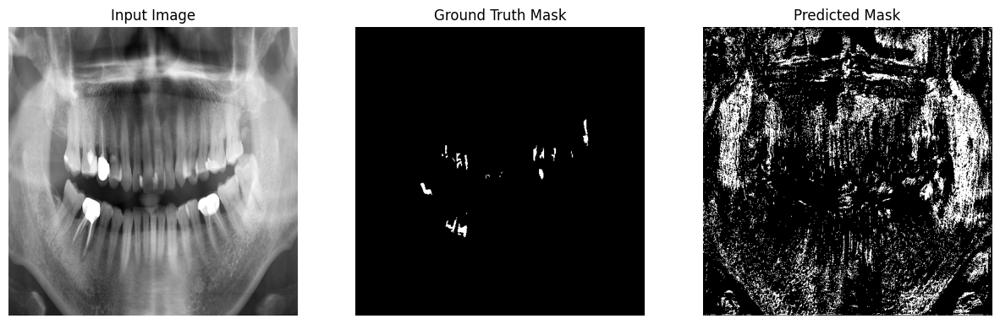

Test Loss: 0.6278 | Dice Score: 0.0838
Epoch 15/50
----------
Train Loss: 0.6314
Dice score for sample 0: 0.0062


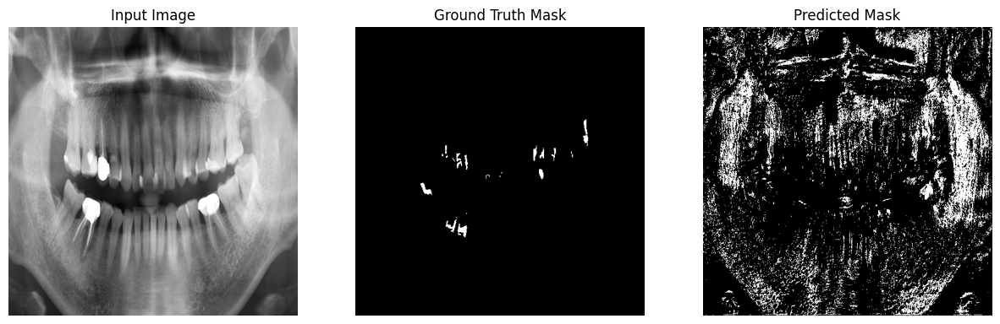

Test Loss: 0.6247 | Dice Score: 0.0831
Epoch 16/50
----------
Train Loss: 0.6304
Dice score for sample 0: 0.0063


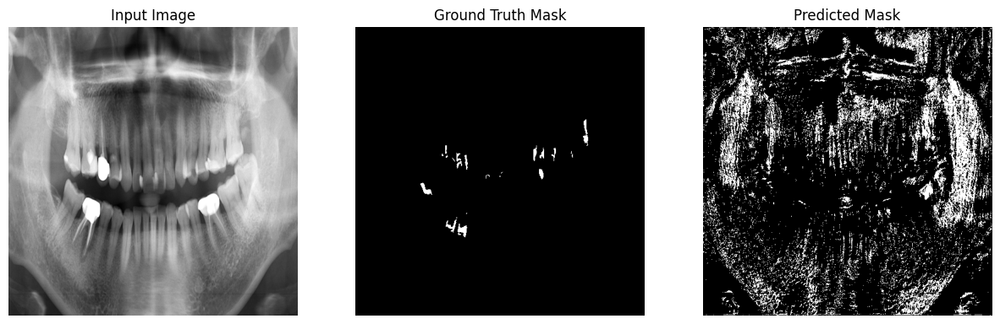

Test Loss: 0.6263 | Dice Score: 0.0829
Epoch 17/50
----------
Train Loss: 0.6295
Dice score for sample 0: 0.0060


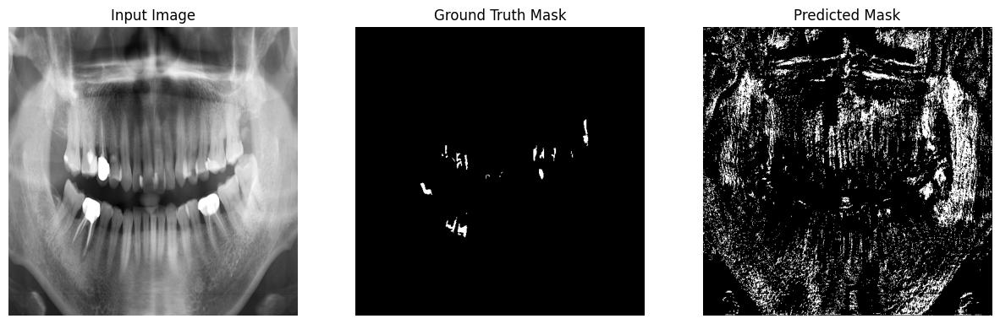

Test Loss: 0.6213 | Dice Score: 0.0789
Epoch 18/50
----------
Train Loss: 0.6321
Dice score for sample 0: 0.0060


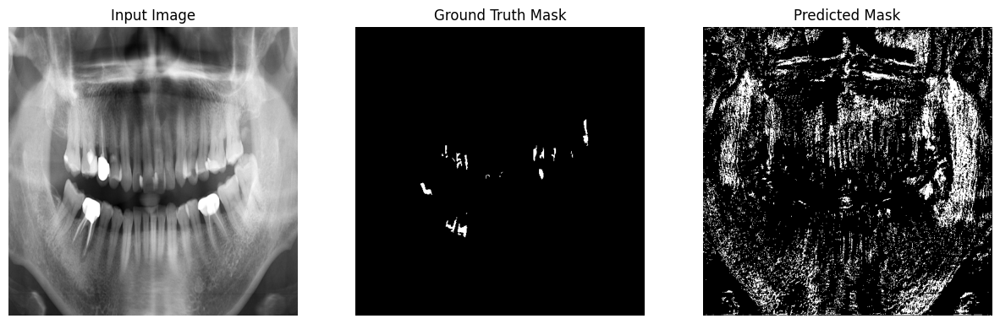

Test Loss: 0.6250 | Dice Score: 0.0818
Epoch 19/50
----------
Train Loss: 0.6332
Dice score for sample 0: 0.0064


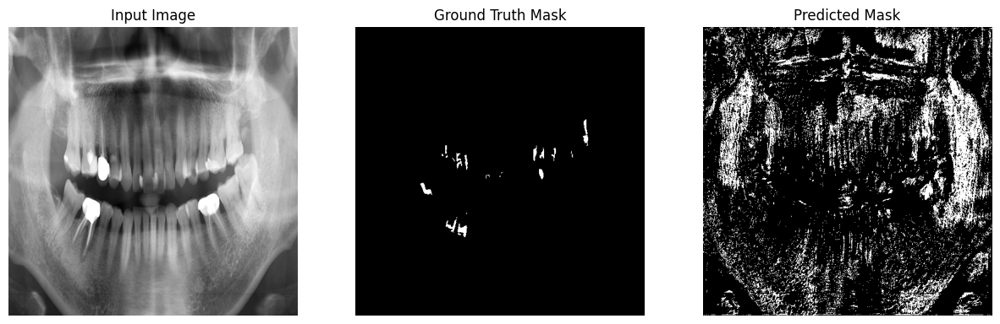

Test Loss: 0.6279 | Dice Score: 0.0840
Epoch 20/50
----------
Train Loss: 0.6299
Dice score for sample 0: 0.0060


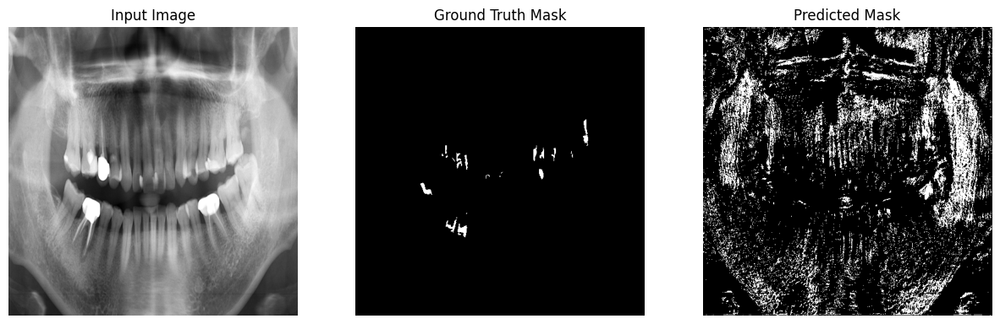

Test Loss: 0.6253 | Dice Score: 0.0821
Epoch 21/50
----------
Train Loss: 0.6316
Dice score for sample 0: 0.0064


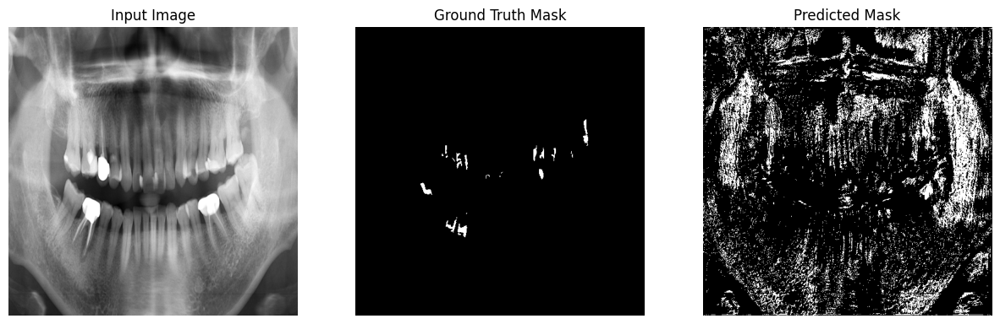

Test Loss: 0.6278 | Dice Score: 0.0833
Epoch 22/50
----------
Train Loss: 0.6351
Dice score for sample 0: 0.0063


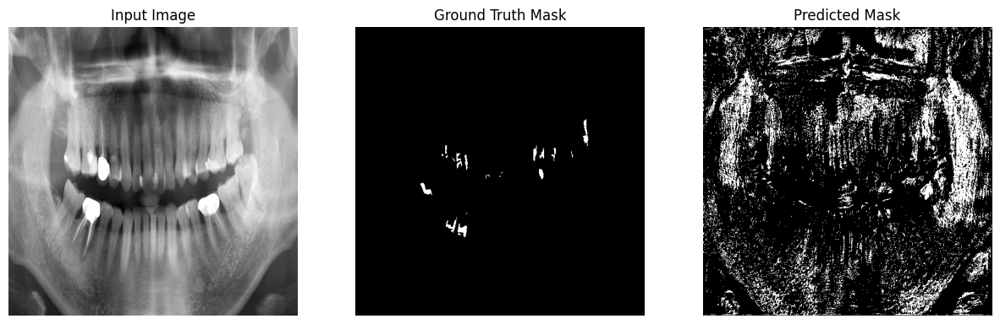

Test Loss: 0.6269 | Dice Score: 0.0825
Epoch 23/50
----------
Train Loss: 0.6324
Dice score for sample 0: 0.0063


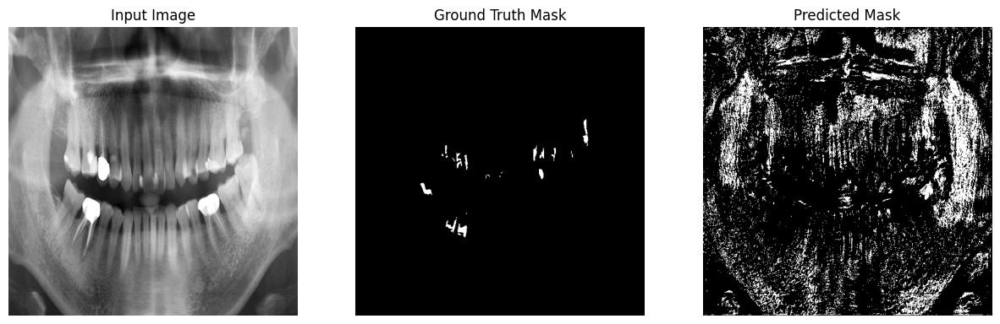

Test Loss: 0.6260 | Dice Score: 0.0820
Epoch 24/50
----------
Train Loss: 0.6304
Dice score for sample 0: 0.0064


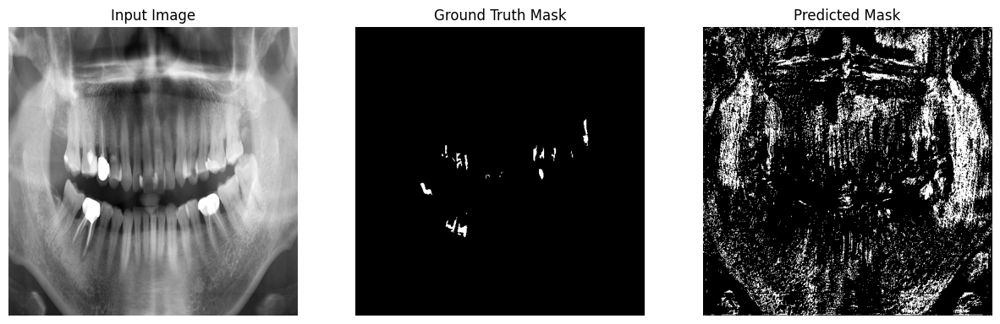

Test Loss: 0.6263 | Dice Score: 0.0825
Epoch 25/50
----------
Train Loss: 0.6298
Dice score for sample 0: 0.0064


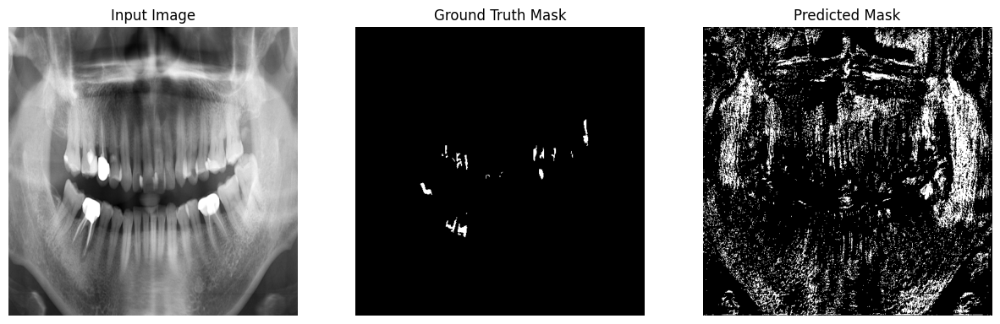

Test Loss: 0.6245 | Dice Score: 0.0805
Epoch 26/50
----------
Train Loss: 0.6330
Dice score for sample 0: 0.0061


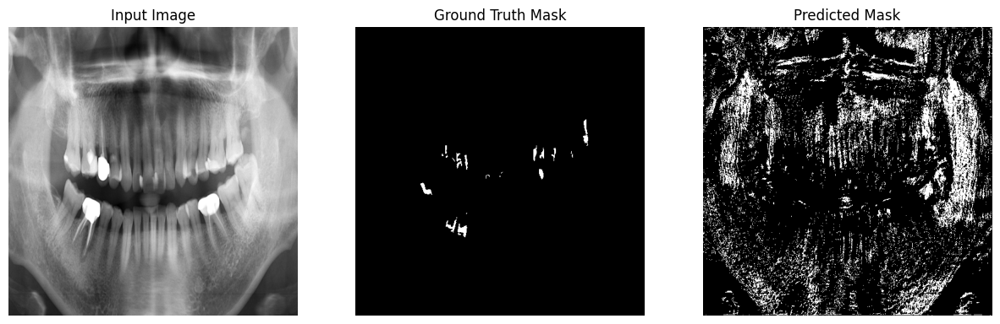

Test Loss: 0.6245 | Dice Score: 0.0816
Epoch 27/50
----------
Train Loss: 0.6289
Dice score for sample 0: 0.0059


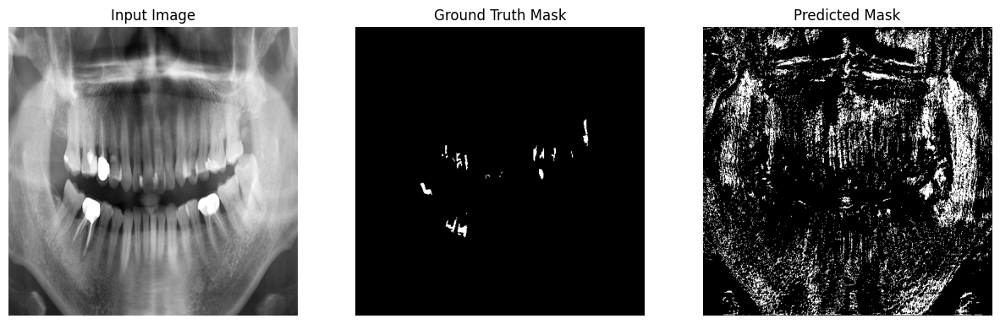

Test Loss: 0.6230 | Dice Score: 0.0804
Epoch 28/50
----------
Train Loss: 0.6328
Dice score for sample 0: 0.0065


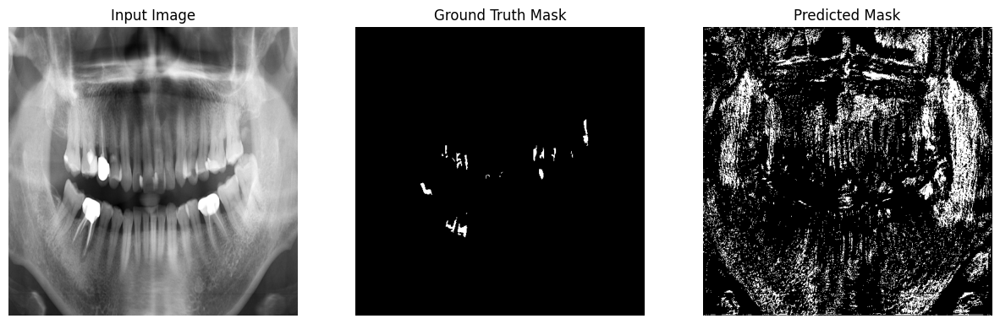

Test Loss: 0.6278 | Dice Score: 0.0825
Epoch 29/50
----------
Train Loss: 0.6307
Dice score for sample 0: 0.0065


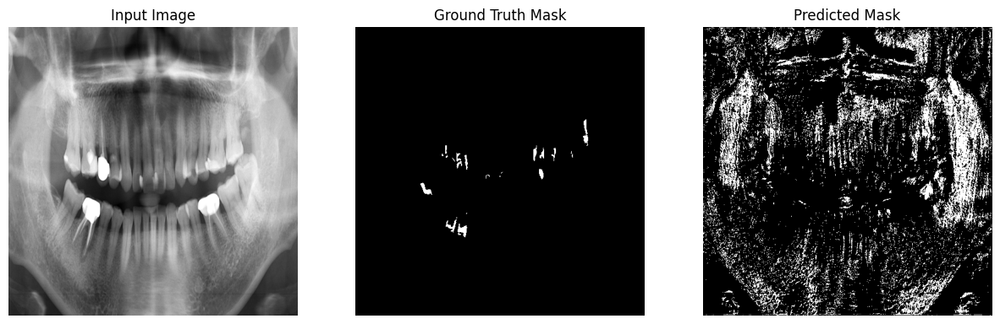

Test Loss: 0.6253 | Dice Score: 0.0826
Epoch 30/50
----------
Train Loss: 0.6319
Dice score for sample 0: 0.0065


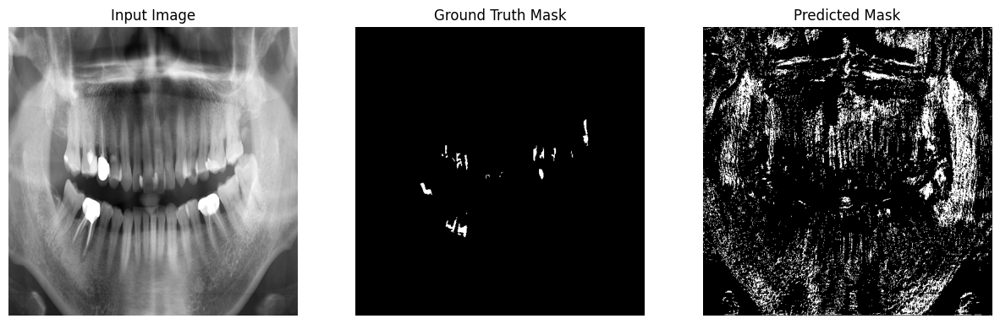

Test Loss: 0.6228 | Dice Score: 0.0795
Epoch 31/50
----------
Train Loss: 0.6321
Dice score for sample 0: 0.0061


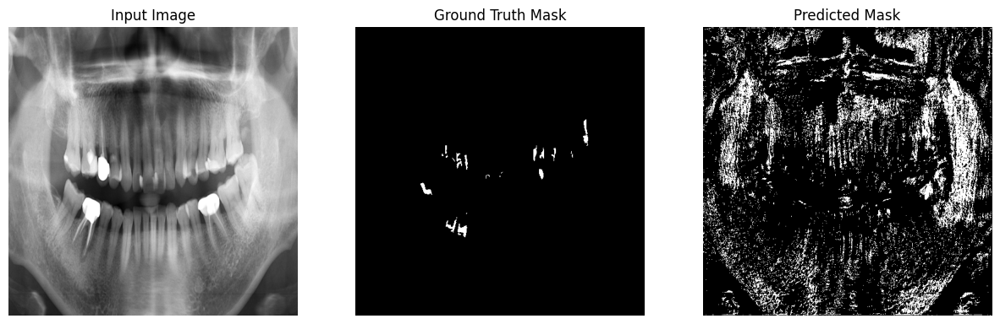

Test Loss: 0.6253 | Dice Score: 0.0820
Epoch 32/50
----------
Train Loss: 0.6298
Dice score for sample 0: 0.0065


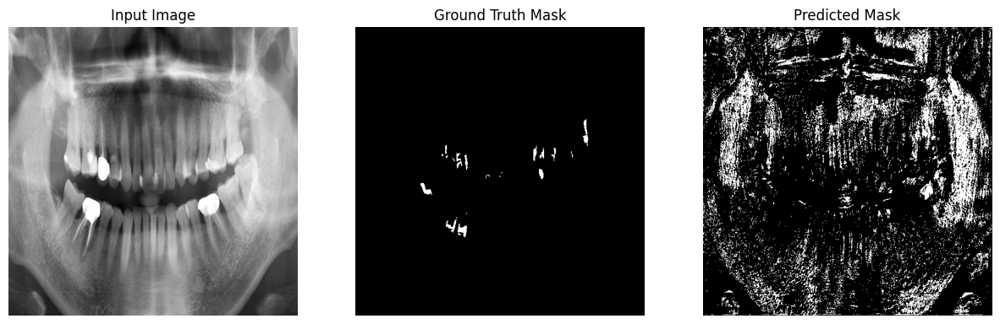

Test Loss: 0.6259 | Dice Score: 0.0824
Epoch 33/50
----------
Train Loss: 0.6326
Dice score for sample 0: 0.0066


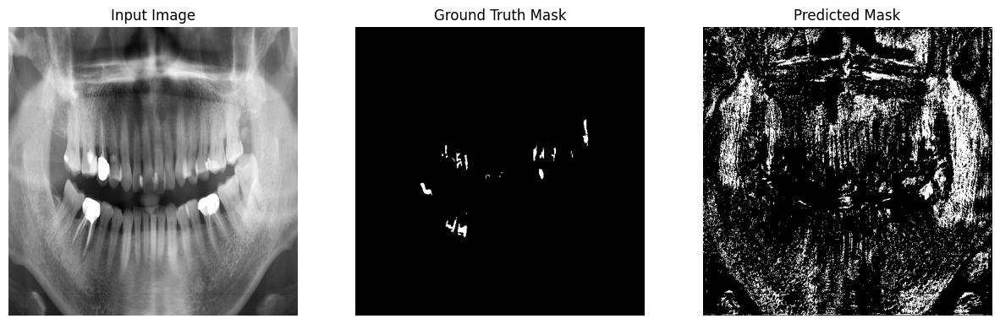

Test Loss: 0.6281 | Dice Score: 0.0833
Epoch 34/50
----------
Train Loss: 0.6306
Dice score for sample 0: 0.0065


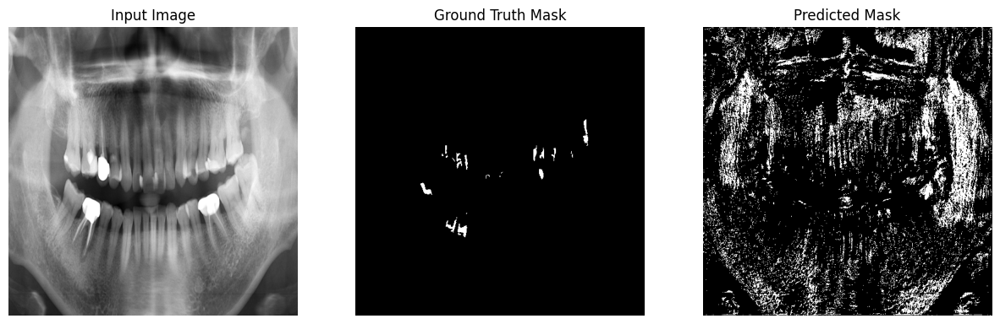

Test Loss: 0.6252 | Dice Score: 0.0812
Epoch 35/50
----------
Train Loss: 0.6326
Dice score for sample 0: 0.0059


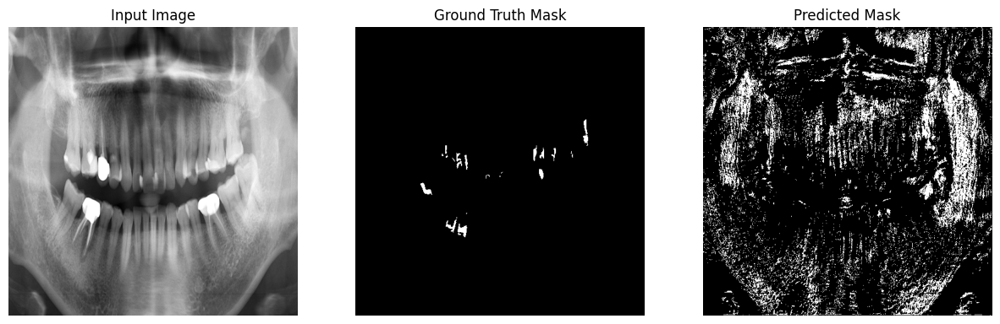

Test Loss: 0.6234 | Dice Score: 0.0805
Epoch 36/50
----------
Train Loss: 0.6290
Dice score for sample 0: 0.0064


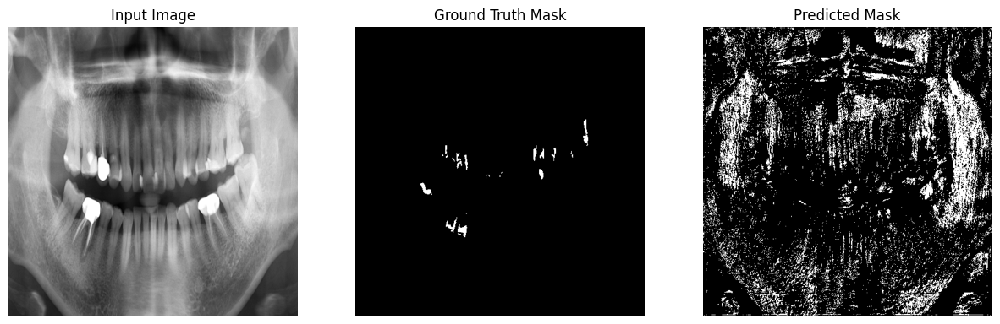

Test Loss: 0.6263 | Dice Score: 0.0824
Epoch 37/50
----------
Train Loss: 0.6332
Dice score for sample 0: 0.0062


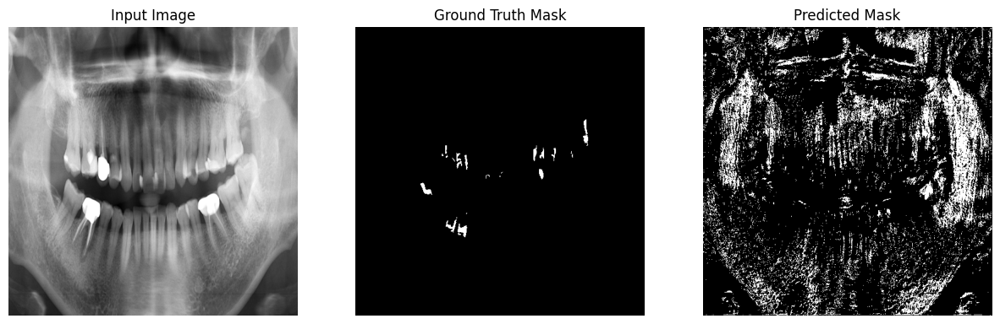

Test Loss: 0.6252 | Dice Score: 0.0830
Epoch 38/50
----------
Train Loss: 0.6310
Dice score for sample 0: 0.0058


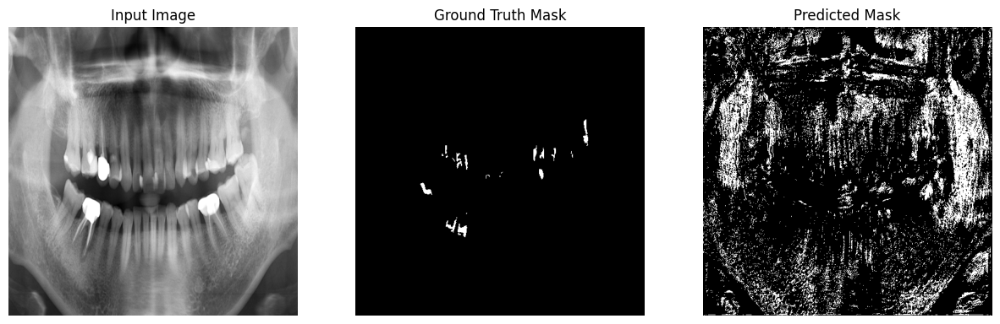

Test Loss: 0.6275 | Dice Score: 0.0835
Epoch 39/50
----------
Train Loss: 0.6323
Dice score for sample 0: 0.0057


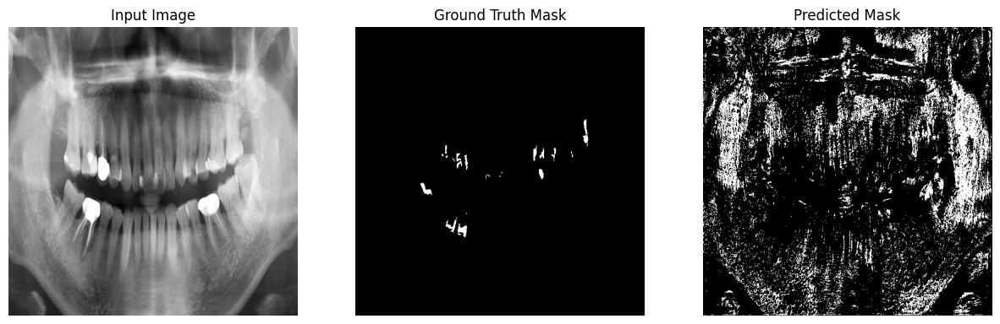

Test Loss: 0.6260 | Dice Score: 0.0843
Epoch 40/50
----------
Train Loss: 0.6302
Dice score for sample 0: 0.0062


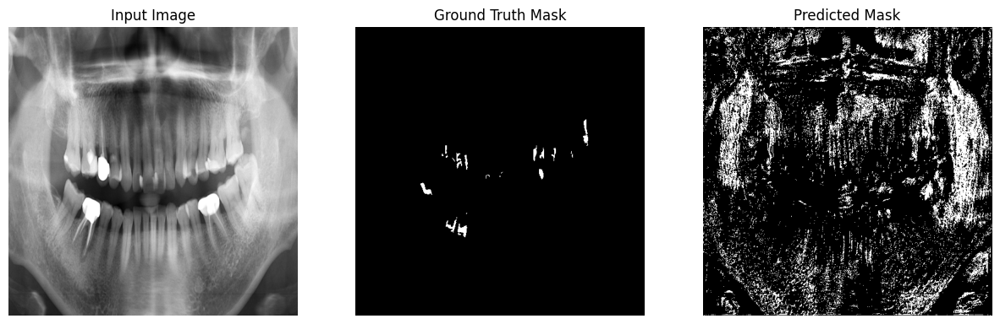

Test Loss: 0.6256 | Dice Score: 0.0813
Epoch 41/50
----------
Train Loss: 0.6308
Dice score for sample 0: 0.0066


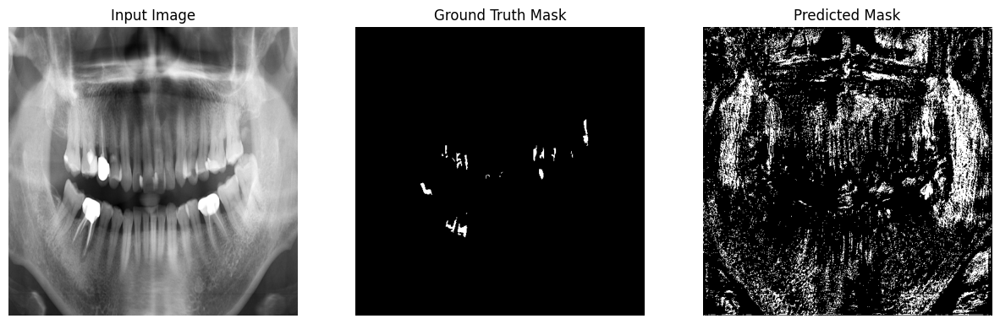

Test Loss: 0.6276 | Dice Score: 0.0817
Epoch 42/50
----------
Train Loss: 0.6313
Dice score for sample 0: 0.0063


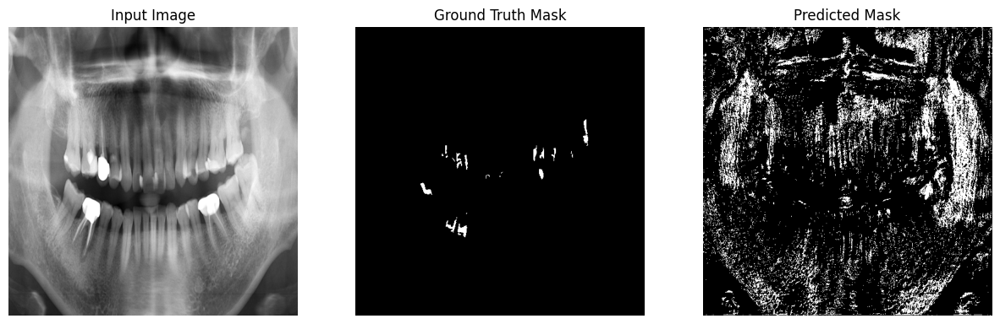

Test Loss: 0.6246 | Dice Score: 0.0814
Epoch 43/50
----------
Train Loss: 0.6315
Dice score for sample 0: 0.0062


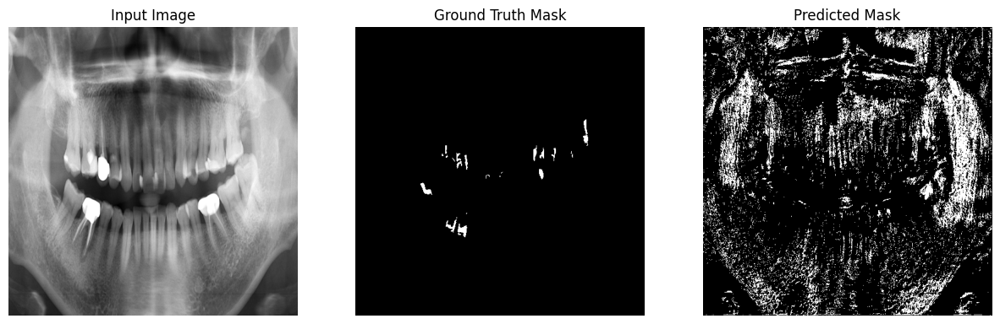

Test Loss: 0.6244 | Dice Score: 0.0818
Epoch 44/50
----------
Train Loss: 0.6311
Dice score for sample 0: 0.0062


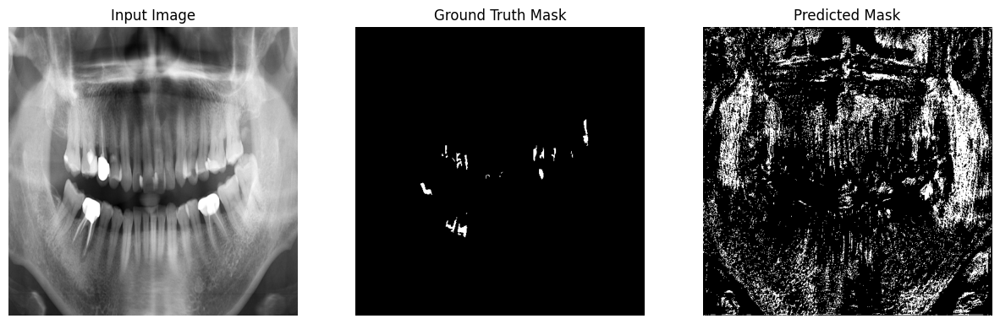

Test Loss: 0.6269 | Dice Score: 0.0825
Epoch 45/50
----------
Train Loss: 0.6318
Dice score for sample 0: 0.0062


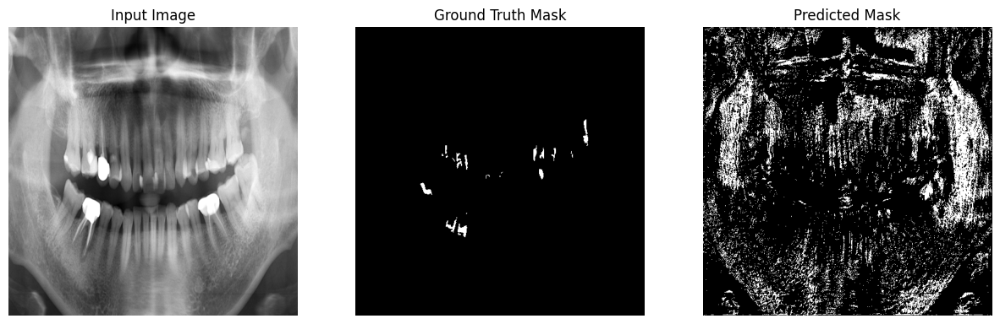

Test Loss: 0.6251 | Dice Score: 0.0828
Epoch 46/50
----------
Train Loss: 0.6300
Dice score for sample 0: 0.0063


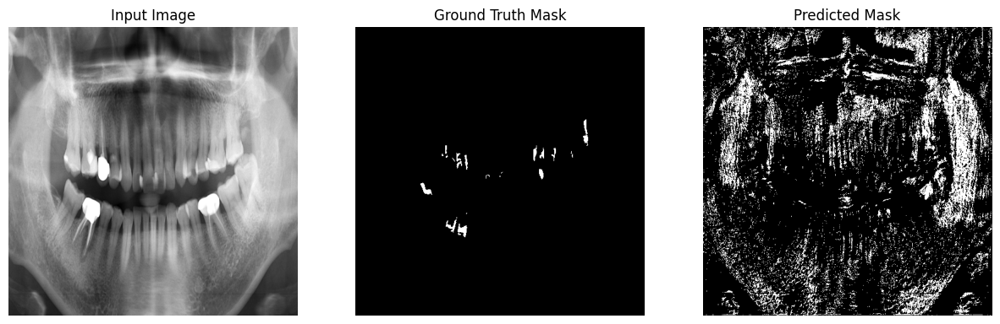

Test Loss: 0.6253 | Dice Score: 0.0815
Epoch 47/50
----------
Train Loss: 0.6305
Dice score for sample 0: 0.0064


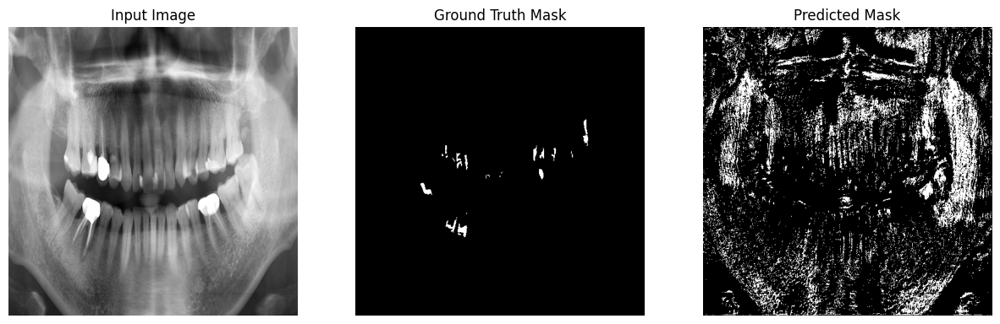

Test Loss: 0.6263 | Dice Score: 0.0823
Epoch 48/50
----------
Train Loss: 0.6279
Dice score for sample 0: 0.0065


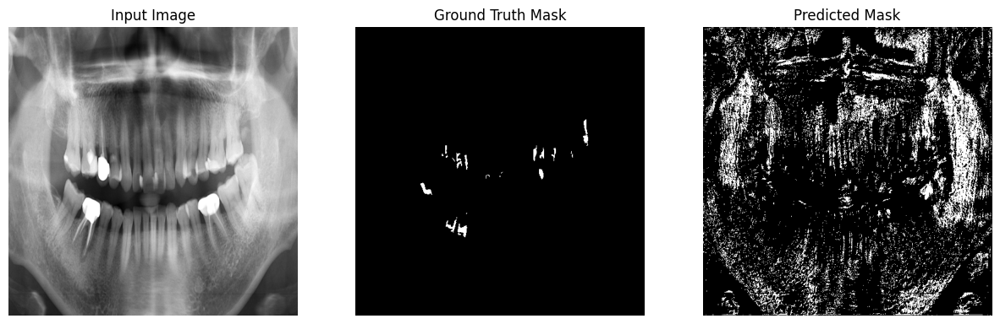

Test Loss: 0.6251 | Dice Score: 0.0815
Epoch 49/50
----------
Train Loss: 0.6293
Dice score for sample 0: 0.0063


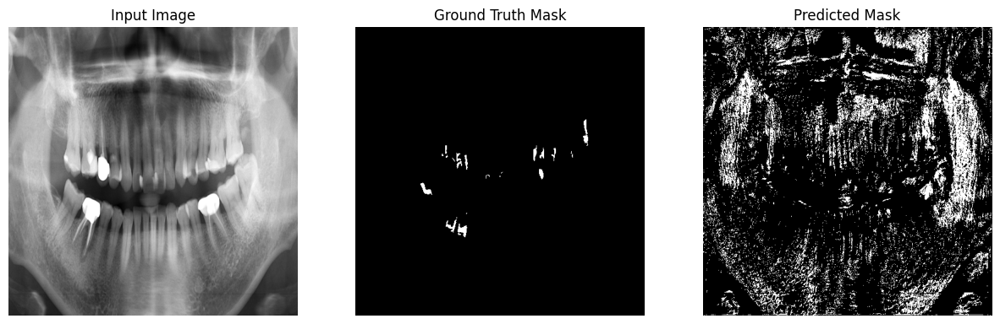

Test Loss: 0.6264 | Dice Score: 0.0820
Epoch 50/50
----------
Train Loss: 0.6298
Dice score for sample 0: 0.0064


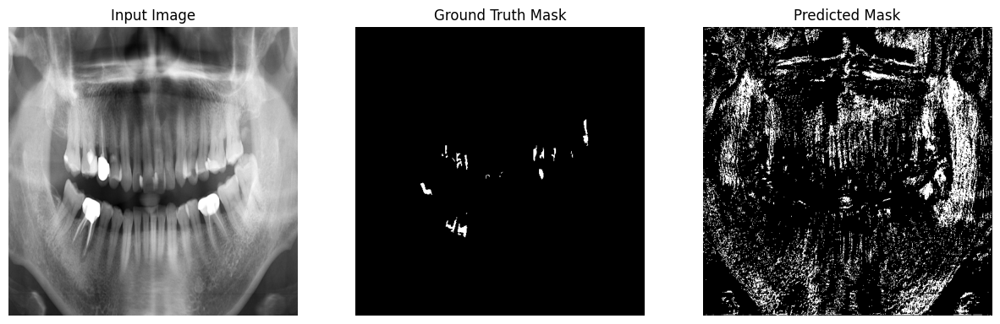

Test Loss: 0.6253 | Dice Score: 0.0813
Training complete in 32m 57s


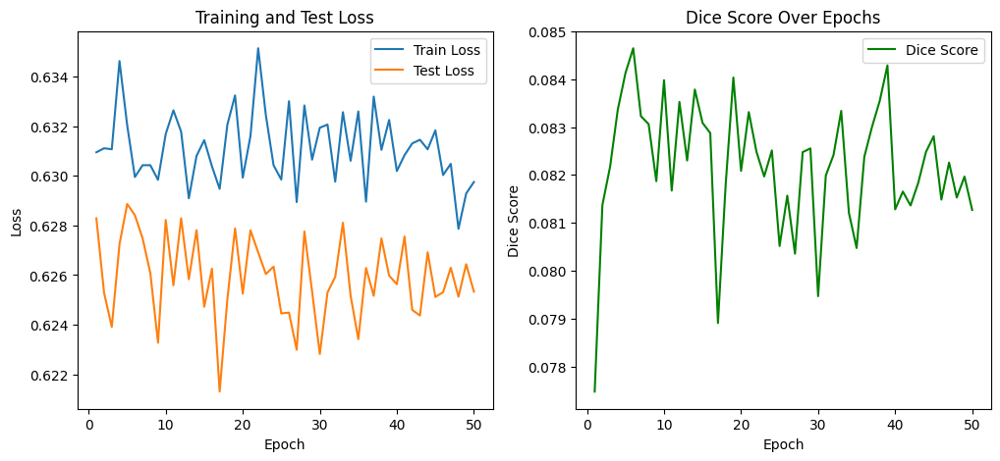

Model saved to model.pth


In [ ]:
# train.py
import os
import numpy as np
from PIL import Image
import torch
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch.nn as nn
import torch.optim as optim
import time
import matplotlib.pyplot as plt

from model import Model  # Ensure model.py is in the same directory

# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define the TeethSegmentationDataset
class TeethSegmentationDataset(Dataset):
    def __init__(self, image_dir: str, mask_dir: str, transform: A.Compose, dataset_type: str = 'Train', noisy_masks: list = None):
        """
        Args:
            image_dir (str): Directory path containing input images.
            mask_dir (str): Directory path containing corresponding segmentation masks.
            transform (callable): Transformation to be applied to both image and mask.
            dataset_type (str, optional): 'Train' or 'Test'. Defaults to 'Train'.
            noisy_masks (list, optional): List of mask filenames to exclude. Defaults to None.
        """
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.dataset_type = dataset_type

        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

        if noisy_masks:
            self.images = [img for img in self.images if img not in noisy_masks]
            self.masks = [mask for mask in self.masks if mask not in noisy_masks]

        number_of_samples = len(self.images)
        split_ratio = 0.8  # 80% training, 20% testing

        if dataset_type == 'Train':
            self.images = self.images[:int(number_of_samples * split_ratio)]
            self.masks = self.masks[:int(number_of_samples * split_ratio)]
        elif dataset_type == 'Test':
            self.images = self.images[int(number_of_samples * split_ratio):]
            self.masks = self.masks[int(number_of_samples * split_ratio):]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        # Load image and mask
        image_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(self.mask_dir, self.masks[index])

        image = np.array(Image.open(image_path).convert("L"))
        mask = np.array(Image.open(mask_path).convert("L"))

        # Apply transformations
        transformed = self.transform(image=image, mask=mask)
        image = transformed['image']
        mask = transformed['mask']

        # Binarize the mask and ensure it has a channel dimension
        binary_mask = (mask > 0).float()  # Shape: (1, 512, 512) if mask has channel

        # Verify the shape of binary_mask
        if binary_mask.dim() == 2:
            binary_mask = binary_mask.unsqueeze(0)  # Add channel dimension

        return image, binary_mask

# Define augmentations
augmenter = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.Rotate(limit=30, p=0.5),
    A.RandomBrightnessContrast(p=0.5),
    A.Normalize(mean=(0.485,), std=(0.229,), max_pixel_value=255.0),
    ToTensorV2(),
])

test_augmenter = A.Compose([
    A.Normalize(mean=(0.485,), std=(0.229,), max_pixel_value=255.0),
    ToTensorV2(),
])

# Initialize datasets and dataloaders
train_dataset = TeethSegmentationDataset(
    image_dir="./Main_teeth_dataset/images",
    mask_dir="./Main_teeth_dataset/labels",
    transform=augmenter,
    dataset_type='Train',
)

test_dataset = TeethSegmentationDataset(
    image_dir="./Main_teeth_dataset/images",
    mask_dir="./Main_teeth_dataset/labels",
    transform=test_augmenter,
    dataset_type='Test',
)

batch_size = 8
num_workers = 2  # Adjusted based on your system's recommendation

dataloaders = {
    'train': DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers),
    'test': DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)
}

print(f"Train dataset size: {len(train_dataset)}")
print(f"Test dataset size: {len(test_dataset)}")

# Define Dice Score Function
def dice_score(pred: torch.Tensor, target_mask: torch.Tensor, epsilon: float = 1e-6) -> float:
    """
    Computes the Dice score between the predicted and target segmentation masks.

    Args:
        pred (torch.Tensor): The predicted mask tensor, with values in range [0, 1].
        target_mask (torch.Tensor): The ground truth mask.
        epsilon (float, optional): A small value to avoid division by zero. Defaults to 1e-6.

    Returns:
        float: The Dice score, a similarity metric between 0 and 1.
    """
    pred = torch.sigmoid(pred) > 0.5  # Threshold logits to get binary predictions
    pred_flat = pred.view(pred.size(0), -1).float()
    target_flat = target_mask.view(target_mask.size(0), -1)

    intersection = (pred_flat * target_flat).sum(dim=1)
    union = pred_flat.sum(dim=1) + target_flat.sum(dim=1)

    dice = (2. * intersection + epsilon) / (union + epsilon)
    return dice.mean().item()

# Define Loss Function and Optimizer
model = Model()
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)

# Visualization Function
def visualize_mask(inputs: torch.Tensor, masks: torch.Tensor, outputs: torch.Tensor):
    """
    Visualizes the input image, ground truth mask, and model's output mask.

    Args:
        inputs (torch.Tensor): Input images tensor.
        masks (torch.Tensor): Ground truth masks tensor.
        outputs (torch.Tensor): Model's output logits tensor.
    """
    sample_index = 0  # Index of the sample to visualize
    channel = 0  # Since masks are single-channel

    dice = dice_score(outputs[sample_index:sample_index+1], masks[sample_index:sample_index+1])
    print(f'Dice score for sample {sample_index}: {dice:.4f}')

    inputs_np = inputs.cpu().numpy()
    masks_np = masks.cpu().numpy()
    outputs_np = torch.sigmoid(outputs).detach().cpu().numpy()

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(inputs_np[sample_index][0], cmap='gray')  # Grayscale image
    plt.title("Input Image")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks_np[sample_index][0], cmap='gray')  # Ground truth mask
    plt.title("Ground Truth Mask")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(outputs_np[sample_index][0] > 0.5, cmap='gray')  # Predicted mask
    plt.title("Predicted Mask")
    plt.axis('off')

    plt.show()

# Training Function
def train_model(model: nn.Module, dataloaders: dict, criterion: nn.Module, optimizer: optim.Optimizer, num_epochs: int = 50) -> nn.Module:
    """
    Trains the model and evaluates it using the Dice score.

    Args:
        model (nn.Module): The PyTorch model to be trained.
        dataloaders (dict): Dictionary containing 'train' and 'test' DataLoaders.
        criterion (nn.Module): Loss function.
        optimizer (optim.Optimizer): Optimizer.
        num_epochs (int, optional): Number of training epochs. Defaults to 50.

    Returns:
        nn.Module: The trained model.
    """
    since = time.time()

    train_losses = []
    test_losses = []
    dice_scores_epoch = []

    model = model.to(device)

    for epoch in range(num_epochs):
        print(f'Epoch {epoch +1}/{num_epochs}')
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'test']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_dice = 0.0

            # Iterate over data
            for inputs, masks in dataloaders[phase]:
                inputs = inputs.to(device)
                masks = masks.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                    else:
                        dice = dice_score(outputs, masks)
                        running_dice += dice * inputs.size(0)

                running_loss += loss.item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)

            if phase == 'train':
                train_losses.append(epoch_loss)
            else:
                epoch_dice = running_dice / len(dataloaders[phase].dataset)
                test_losses.append(epoch_loss)
                dice_scores_epoch.append(epoch_dice)

                # Visualize predictions
                visualize_mask(inputs, masks, outputs)

            print(f'{phase.capitalize()} Loss: {epoch_loss:.4f}', end='')
            if phase == 'test':
                print(f' | Dice Score: {epoch_dice:.4f}')
            else:
                print()

    time_elapsed = time.time() - since
    print(f'Training complete in {int(time_elapsed // 60)}m {int(time_elapsed % 60)}s')

    # Plot Loss and Dice Score
    epochs_range = range(1, num_epochs + 1)
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, train_losses, label='Train Loss')
    plt.plot(epochs_range, test_losses, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Test Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, dice_scores_epoch, label='Dice Score', color='green')
    plt.xlabel('Epoch')
    plt.ylabel('Dice Score')
    plt.title('Dice Score Over Epochs')
    plt.legend()

    plt.show()

    return model

# Initialize and Train the Model
model = Model()
model = train_model(model, dataloaders, criterion, optimizer, num_epochs=50)

# Save the trained model
model_save_path = "model.pth"
torch.save(model.cpu().state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")


In [ ]:
!rm model.py model.pth

rm: cannot remove 'model.pth': No such file or directory


In [ ]:
!ls

drive  Main_teeth_dataset  model.py  __pycache__  sample_data


In [ ]:
!ls /content/Main_teeth_dataset

images	labels	Main_teeth_dataset.zip


In [ ]:
!rm -rf __pycache__

In [ ]:
!touch model.py

In [ ]:
import zipfile
import os

def zip_multiple_files(input_paths, output_zip_path, compression_level=5):
    # Ensure compression level is within 1-9
    compression_level = max(1, min(compression_level, 1))

    # Create a zip file with the specified compression level
    compression = zipfile.ZIP_DEFLATED

    # Create the zip file
    with zipfile.ZipFile(output_zip_path, 'w', compression) as zipf:
        for input_path in input_paths:
            # Check if the file or directory exists
            if not os.path.exists(input_path):
                print(f"{input_path} does not exist.")
                continue

            # If it's a directory, recursively add files
            if os.path.isdir(input_path):
                for root, dirs, files in os.walk(input_path):
                    for file in files:
                        file_full_path = os.path.join(root, file)
                        zipf.write(file_full_path,
                                   os.path.relpath(file_full_path,
                                                   os.path.join(input_path, '..')))
            # If it's a single file, add it to the zip file
            else:
                zipf.write(input_path, os.path.basename(input_path))

    print(f"Successfully zipped files to {output_zip_path} with compression level {compression_level}")

# Example usage:
input_paths = ['/content/model.py', '/content/model.pth']  # List of files or directories to zip
output_zip_path = '/content/submission0.19.zip'  # Path to save the output zip file
compression_level = 5  # Compression level from 1 (fastest) to 9 (most compressed)
zip_multiple_files(input_paths, output_zip_path, compression_level)


In [ ]:
!cp /content/submission0.19.zip /content/drive/MyDrive/ML/Rayan/Q1/submission